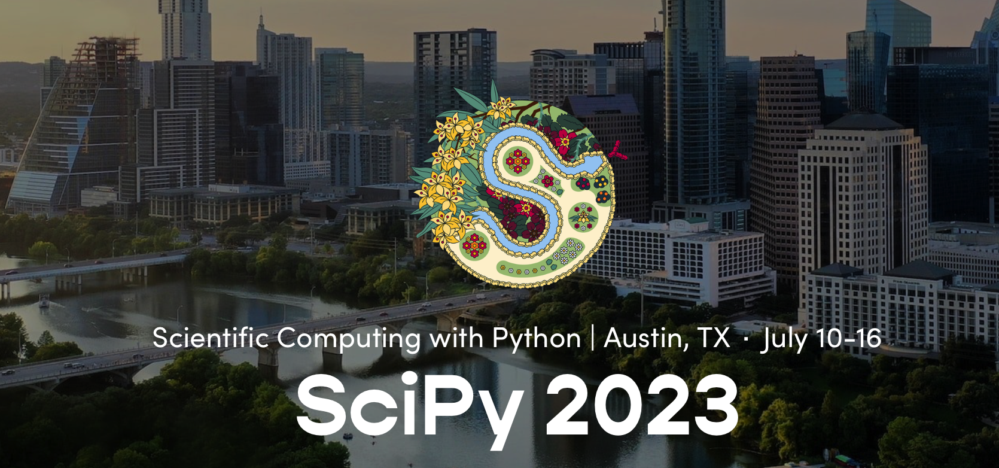

# Understanding the structure of cities through the lens of data

### [Martin Fleischmann] & [James D. Gaboardi]

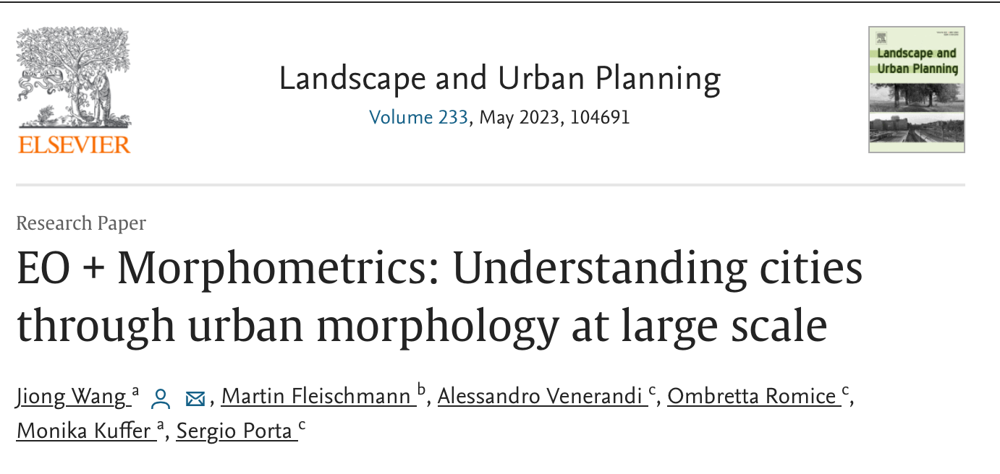

Urban Systems Abstraction Hierarchy (USAH)

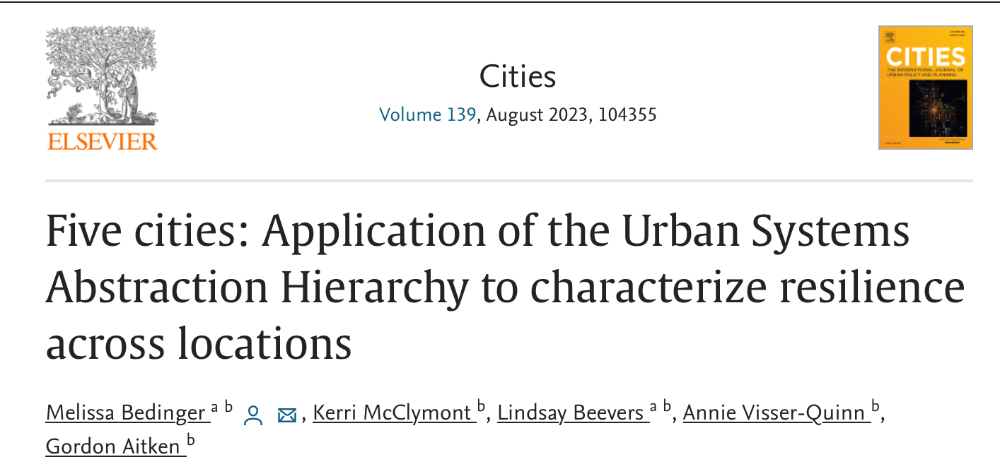

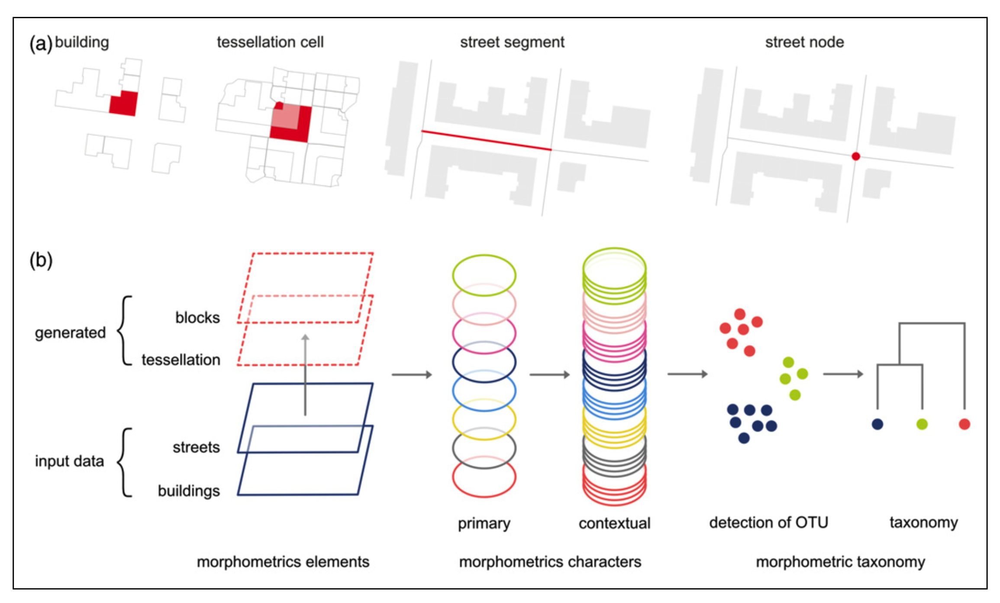

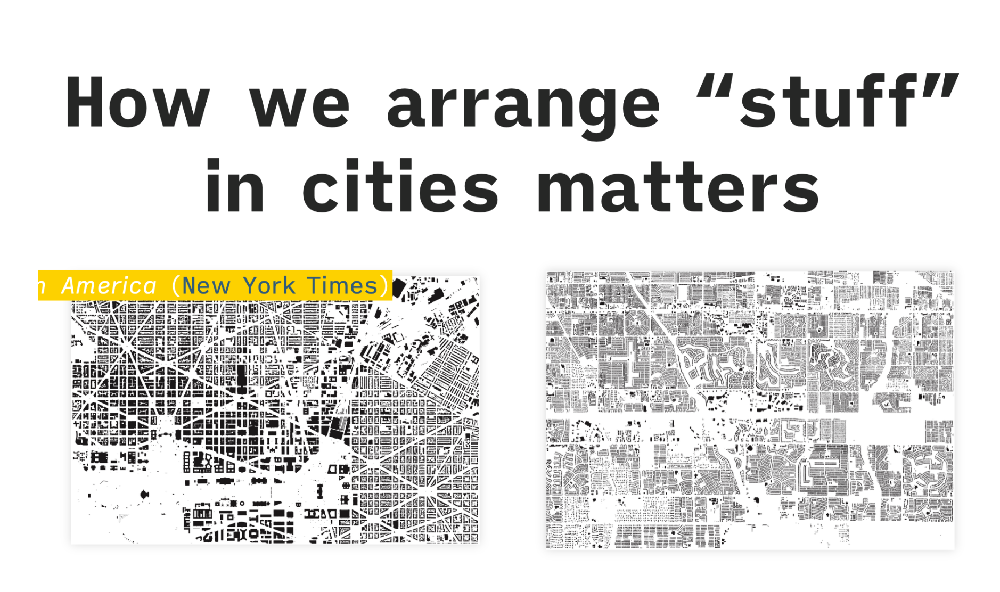

## Agenda
1. Wrangling input data
2. Generating & combining morphometric elements
3. Measuring morphometric characters
4. Understanding context & clustering
5. Wrap up
-------------------------

In [1]:
import bokeh
from bokeh.io import output_notebook
from bokeh.plotting import show
import clustergram
import contextily
import geopandas
import libpysal
import matplotlib.pyplot as plt
import momepy
import osmnx
import pandas
import tqdm
import warnings
bokeh.io.output_notebook()

TypeError: 'bytes' object cannot be interpreted as an integer

In [3]:
! pip list | grep pandas


geopandas                     0.13.2
pandas                        2.0.3


----------------------------------

## 1. Wrangling input data

### Pick a place and set its local CRS.
This should ideally be a town with a good coverage in [OpenStreetMap](https://www.openstreetmap.org).

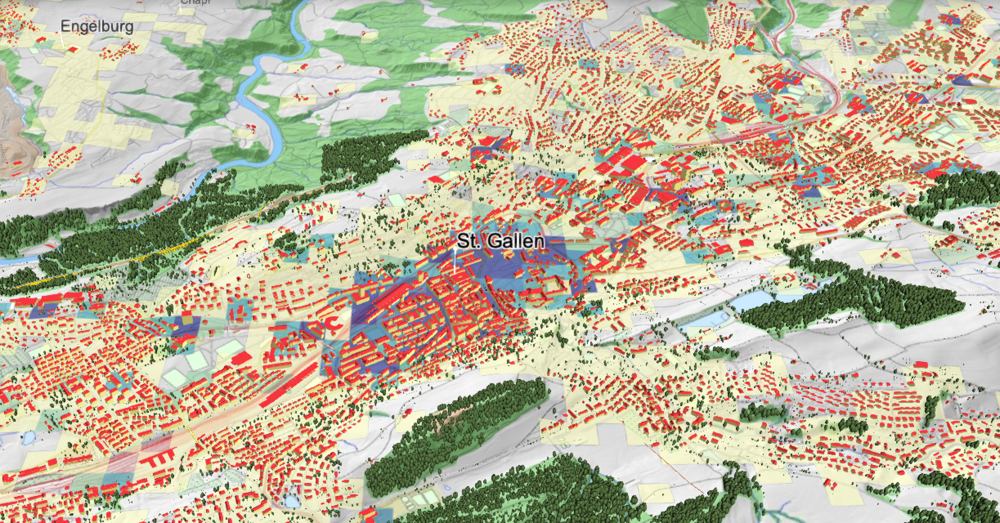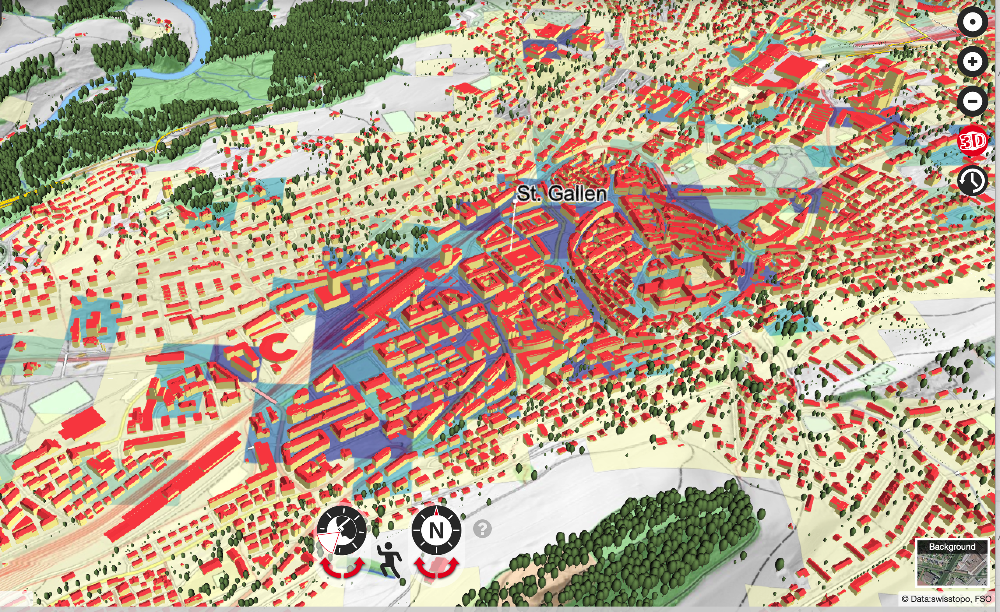

In [2]:
place = "Sankt Gallen"
local_crs = 2056

Explore with [`geopandas`](https://geopandas.org/en/stable/).

In [3]:
geopandas.tools.geocode(place).explore()

### Download data from OpenStreetMap.

Query OSM with [`osmnx`](https://osmnx.readthedocs.io/en/stable/).

#### Buildings

In [4]:
buildings = osmnx.geometries.geometries_from_place(place, tags={"building": True})
buildings.head()

/tmp/ipykernel_10439/3977083449.py:1: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  buildings = osmnx.geometries.geometries_from_place(place, tags={"building": True})


building                            name  \
element_type osmid                                                    
node         60264440           yes                         Bruggen   
             2323346630         yes                             NaN   
             8570699043  university  ArchitekturWerkstatt St.Gallen   
way          4087332         retail                             NaN   
             33118382           yes             Tonhalle St. Gallen   

                                                                  geometry  \
element_type osmid                                                           
node         60264440                             POINT (9.33227 47.40852)   
             2323346630                           POINT (9.41237 47.43742)   
             8570699043                           POINT (9.37001 47.42238)   
way          4087332     POLYGON ((9.37131 47.42203, 9.37134 47.42200, ...   
             33118382    POLYGON ((9.37984 47.42787, 9.37956 47.42772, ...   

                        level   addr:city addr:housenumber addr:postcode  \
element_type osmid                                                         
node         60264440     NaN         NaN              NaN           NaN   
             2323346630   NaN         NaN              NaN           NaN   
             8570699043   NaN   St.Gallen               40          9000   
way          4087332      NaN         NaN              NaN           NaN   
             33118382     NaN  St. Gallen               25          9000   

                                  addr:street access fixme  ... payment:myone  \
element_type osmid                                          ...                 
node         60264440                     NaN    NaN   NaN  ...           NaN   
             2323346630                   NaN    NaN   NaN  ...           NaN   
             8570699043  St. Leonhard-Strasse    NaN   NaN  ...           NaN   
way          4087332                      NaN    NaN   NaN  ...           NaN   
             33118382           Museumstrasse    NaN   NaN  ...           NaN   

                        maxweight female fuel:e85 tower:platforms tower:type  \
element_type osmid                                                             
node         60264440         NaN    NaN      NaN             NaN        NaN   
             2323346630       NaN    NaN      NaN             NaN        NaN   
             8570699043       NaN    NaN      NaN             NaN        NaN   
way          4087332          NaN    NaN      NaN             NaN        NaN   
             33118382         NaN    NaN      NaN             NaN        NaN   

                        crop building:flats ways type  
element_type osmid                                     
node         60264440    NaN            NaN  NaN  NaN  
             2323346630  NaN            NaN  NaN  NaN  
             8570699043  NaN            NaN  NaN  NaN  
way          4087332     NaN            NaN  NaN  NaN  
             33118382    NaN            NaN  NaN  NaN  

[5 rows x 207 columns]

In [5]:
buildings.geom_type.value_counts()

Polygon    9700
Point         3
Name: count, dtype: int64

In [6]:
buildings = buildings[buildings.geom_type == "Polygon"].reset_index(drop=True)

In [7]:
buildings.shape

(9700, 207)

In [8]:
buildings.geometry.explore(prefer_canvas=True, tiles="CartoDB Positron")

In [9]:
buildings = buildings[["geometry"]].to_crs(local_crs)

In [10]:
buildings["uID"] = range(len(buildings))
buildings

,geometry,uID
0,"POLYGON ((2745822.443 1254153.872, 2745824.518...",0
1,"POLYGON ((2746449.518 1254819.049, 2746429.299...",1
2,"POLYGON ((2746509.960 1254751.268, 2746508.185...",2
3,"POLYGON ((2746445.297 1254531.257, 2746472.586...",3
4,"POLYGON ((2746474.491 1254503.252, 2746477.720...",4
...,...,...
9695,"POLYGON ((2740846.790 1252438.153, 2740841.632...",9695
9696,"POLYGON ((2745361.531 1253007.238, 2745362.129...",9696
9697,"POLYGON ((2746181.556 1254487.989, 2746176.648...",9697
9698,"POLYGON ((2743308.429 1252780.672, 2743297.631...",9698


#### Streets

In [11]:
osm_graph = osmnx.graph_from_place(place, network_type="drive")

In [12]:
osm_graph = osmnx.projection.project_graph(osm_graph, to_crs=local_crs)

In [13]:
streets = osmnx.graph_to_gdfs(osm_graph, nodes=False, node_geometry=False)
streets.head()

osmid  \
u          v          key                                                      
2113451    1398243305 0                       [24857768, 24857766, 24857767]   
           2113452    0                              [1150710632, 334585645]   
1398243305 268303180  0                                            126030573   
           268303178  0                                            415815097   
2113452    2113454    0    [334585581, 25525905, 25525906, 334585523, 334...   

                           oneway   lanes  ref        highway  maxspeed  \
u          v          key                                                 
2113451    1398243305 0      True  [1, 2]   A1  motorway_link  [60, 80]   
           2113452    0      True       2   A1       motorway        80   
1398243305 268303180  0      True       1  NaN      secondary        50   
           268303178  0      True       1   A1  motorway_link        60   
2113452    2113454    0      True  [3, 2]   A1       motorway        80   

                          reversed    length tunnel  \
u          v          key                             
2113451    1398243305 0      False   542.830    yes   
           2113452    0      False   326.997    yes   
1398243305 268303180  0      False    71.669    NaN   
           268303178  0      False    15.105    NaN   
2113452    2113454    0      False  1730.273    yes   

                                                                    geometry  \
u          v          key                                                      
2113451    1398243305 0    LINESTRING (2747289.175 1255492.355, 2747264.0...   
           2113452    0    LINESTRING (2747289.175 1255492.355, 2747265.9...   
1398243305 268303180  0    LINESTRING (2746834.060 1255265.868, 2746822.2...   
           268303178  0    LINESTRING (2746834.060 1255265.868, 2746832.5...   
2113452    2113454    0    LINESTRING (2746968.616 1255424.259, 2746936.3...   

                                           name bridge access width junction  
u          v          key                                                     
2113451    1398243305 0                     NaN    NaN    NaN   NaN      NaN  
           2113452    0                     NaN    NaN    NaN   NaN      NaN  
1398243305 268303180  0           Sonnenstrasse    NaN    NaN   NaN      NaN  
           268303178  0                     NaN    NaN    NaN   NaN      NaN  
2113452    2113454    0    Rosenbergtunnel Nord    NaN    NaN   NaN      NaN

In [14]:
streets.geometry.explore(prefer_canvas=True, tiles="CartoDB Positron")

In [16]:
streets = momepy.remove_false_nodes(streets)
streets = streets[["geometry"]]
streets["nID"] = range(len(streets))
streets

/home/conda/global/3b39f5ba4c243d8e72bd1fb8fc9d66b12ee0df9b6209421efb783fde15272f07-20230707-231950-859704-37-answering-geospatial-questions/lib/python3.10/site-packages/geopandas/array.py:1486: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as CH1903+ / LV95 (the single non-null crs provided).
  warnings.warn(


,geometry,nID
0,"LINESTRING (2747289.175 1255492.355, 2747264.0...",0
1,"LINESTRING (2747289.175 1255492.355, 2747265.9...",1
2,"LINESTRING (2746834.060 1255265.868, 2746822.2...",2
3,"LINESTRING (2746834.060 1255265.868, 2746832.5...",3
4,"LINESTRING (2746968.616 1255424.259, 2746936.3...",4
...,...,...
3270,"LINESTRING (2749759.485 1254044.197, 2749759.7...",3270
3271,"LINESTRING (2749951.509 1253547.104, 2749946.1...",3271
3272,"LINESTRING (2750170.247 1253813.027, 2750174.4...",3272
3273,"LINESTRING (2750476.866 1254619.251, 2750471.7...",3273


---------------

## 2. Generating & combining morphometric elements
### Create a tessellation.

Given the following building footprints:

![blg](http://docs.momepy.org/en/stable/_images/user_guide_elements_tessellation_3_0.png)

We can generate a spatial units using Voronoi tessellation:

In [17]:
bubenec = momepy.datasets.get_path("bubenec")
bubenec_blg = geopandas.read_file(bubenec, layer="buildings")
bubenec_tess = geopandas.read_file(bubenec, layer="tessellation")

In [18]:
toner_lite = contextily.providers.Stamen.TonerLite

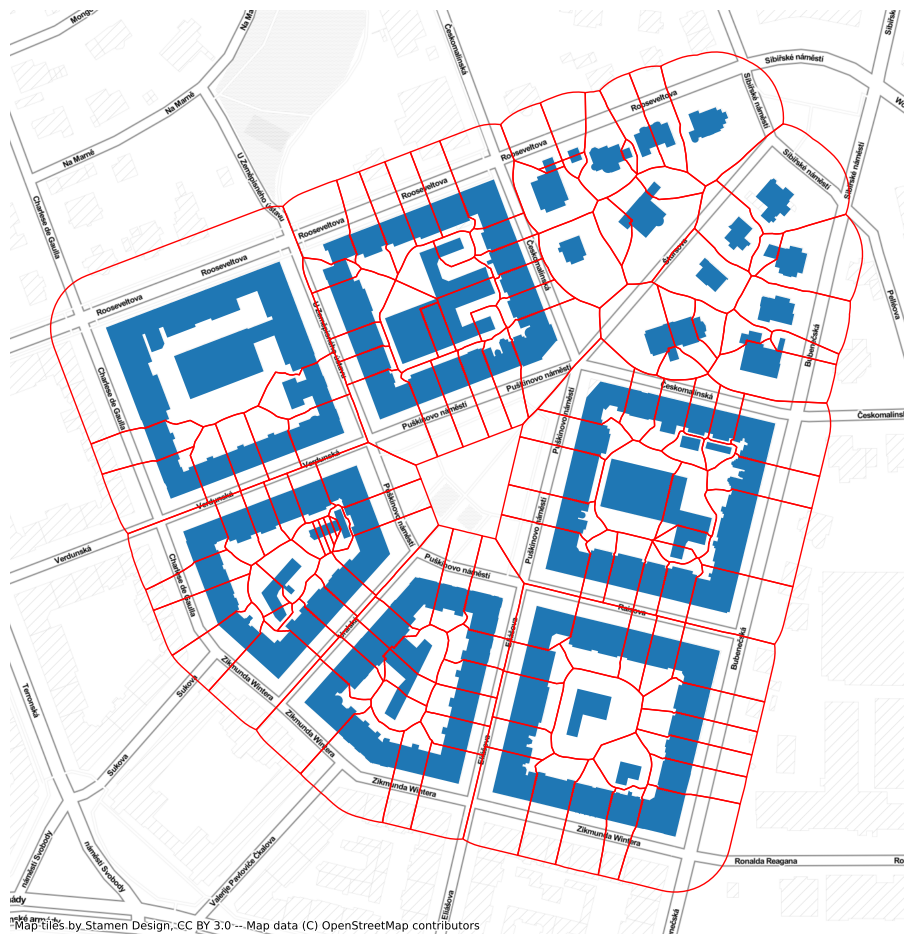

In [19]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    ax = bubenec_blg.plot(figsize=(12, 12))
    bubenec_tess.plot(ax=ax, facecolor="none", edgecolor="r")
    contextily.add_basemap(ax=ax, crs=bubenec_tess.crs, source=toner_lite)
    ax.set_axis_off()

In [20]:
limit = momepy.buffered_limit(buildings, 100)
tessellation = momepy.Tessellation(buildings, "uID", limit, segment=1).tessellation

Inward offset...
Generating input point array...
Generating Voronoi diagram...
Generating GeoDataFrame...
Dissolving Voronoi polygons...


/tmp/ipykernel_10439/104060362.py:2: UserWarning: Tessellation contains MultiPolygon elements. Initial objects should  be edited. `unique_id` of affected elements: [9291, 8291, 8293, 5058, 1983].
  tessellation = momepy.Tessellation(buildings, "uID", limit, segment=1).tessellation


#### Link streets

Link unique IDs of streets to buildings and tessellation cells based on the nearest neighbor join.

In [21]:
buildings = buildings.sjoin_nearest(streets, max_distance=1000, how="left")
buildings

,geometry,uID,index_right,nID
0,"POLYGON ((2745822.443 1254153.872, 2745824.518...",0,679.0,679.0
1,"POLYGON ((2746449.518 1254819.049, 2746429.299...",1,1757.0,1757.0
1,"POLYGON ((2746449.518 1254819.049, 2746429.299...",1,1759.0,1759.0
2,"POLYGON ((2746509.960 1254751.268, 2746508.185...",2,1757.0,1757.0
2,"POLYGON ((2746509.960 1254751.268, 2746508.185...",2,1759.0,1759.0
...,...,...,...,...
9696,"POLYGON ((2745361.531 1253007.238, 2745362.129...",9696,3096.0,3096.0
9697,"POLYGON ((2746181.556 1254487.989, 2746176.648...",9697,197.0,197.0
9698,"POLYGON ((2743308.429 1252780.672, 2743297.631...",9698,414.0,414.0
9699,"POLYGON ((2749129.044 1256648.064, 2749163.756...",9699,2304.0,2304.0


In [22]:
buildings = buildings.drop_duplicates("uID").drop(columns="index_right")

In [23]:
tessellation = tessellation.merge(buildings[["uID", "nID"]], on="uID", how="left")

--------------------


## 3. Measuring morphometric characters
### Measure individual morphometric characters.
#### Dimensions

In [24]:
buildings["area"] = buildings.area
tessellation["area"] = tessellation.area
streets["length"] = streets.length

#### Shape

In [25]:
buildings["eri"] = momepy.EquivalentRectangularIndex(buildings).series

In [26]:
buildings["elongation"] = momepy.Elongation(buildings).series

In [27]:
tessellation["convexity"] = momepy.Convexity(tessellation).series

In [28]:
streets["linearity"] = momepy.Linearity(streets).series

Declare some plotting symbology and cartographic elements that we can reuse.

In [29]:
symb_kws = dict(scheme="natural_breaks", legend=True)
font_kws = dict(fontdict={"fontsize":20})

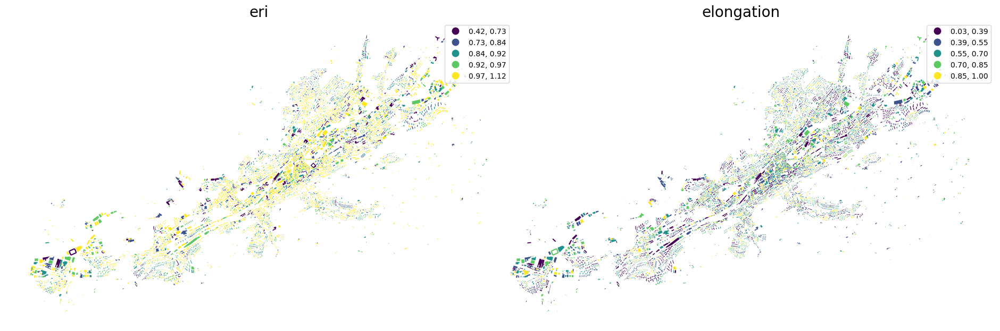

In [30]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))
for i, col in enumerate(["eri", "elongation"]):
    buildings.plot(col, ax=ax[i], **symb_kws)
    ax[i].set_title(col, **font_kws)
    ax[i].set_axis_off()
fig.subplots_adjust(wspace=-.05)

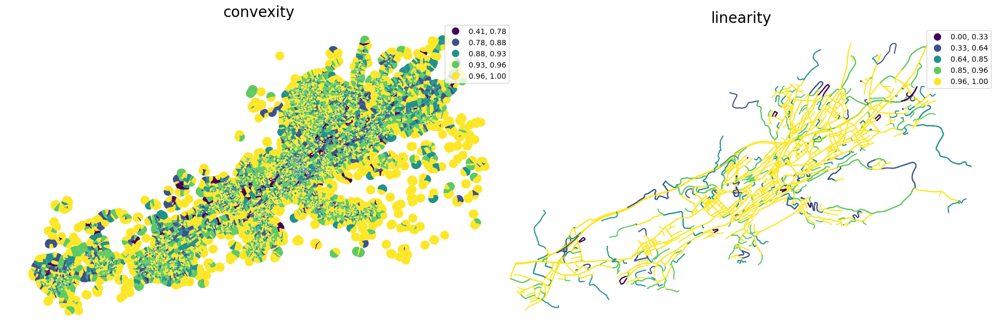

In [31]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))
for i, (df, col) in enumerate(zip([tessellation, streets], ["convexity", "linearity"])):
    df.plot(col, ax=ax[i], **symb_kws)
    ax[i].set_title(col, **font_kws)
    ax[i].set_axis_off()
fig.subplots_adjust(wspace=-.05)

#### Spatial distribution

In [32]:
buildings["shared_walls"] = momepy.SharedWallsRatio(buildings).series

/home/conda/global/3b39f5ba4c243d8e72bd1fb8fc9d66b12ee0df9b6209421efb783fde15272f07-20230707-231950-859704-37-answering-geospatial-questions/lib/python3.10/site-packages/momepy/distribution.py:135: FutureWarning: The `query_bulk()` method is deprecated and will be removed in GeoPandas 1.0. You can use the `query()` method instead.
  inp, res = gdf.sindex.query_bulk(gdf.geometry, predicate="intersects")


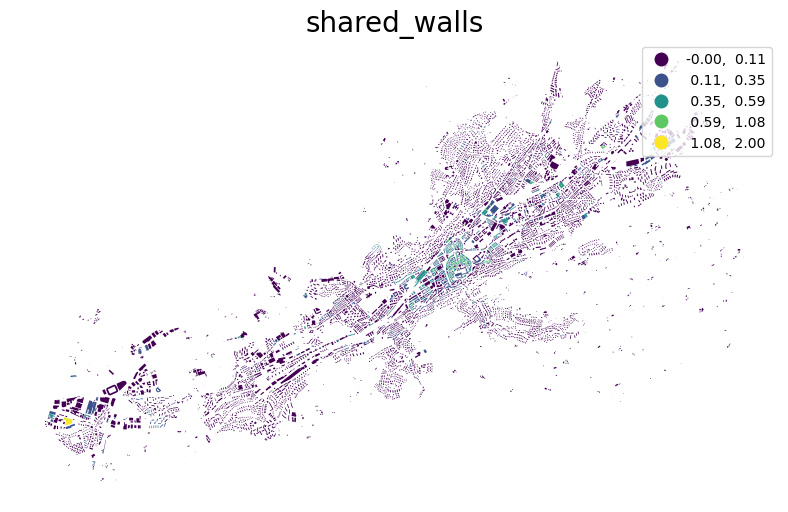

In [33]:
ax = buildings.plot("shared_walls", figsize=(12, 6), **symb_kws)
ax.set_title("shared_walls", **font_kws)
ax.set_axis_off()

Generate spatial weights matrices using [`libpysal`](https://github.com/pysal/libpysal).

What are they?

In [34]:
w = libpysal.weights.Queen.from_dataframe(bubenec_tess)

In [35]:
edge_kws = dict(color="b", linewidth=1)
node_kws = dict(marker="")
wght_kws = dict(edge_kws=edge_kws, node_kws=node_kws)

TypeError: Passing a dict as an indexer is not supported. Use a list instead.

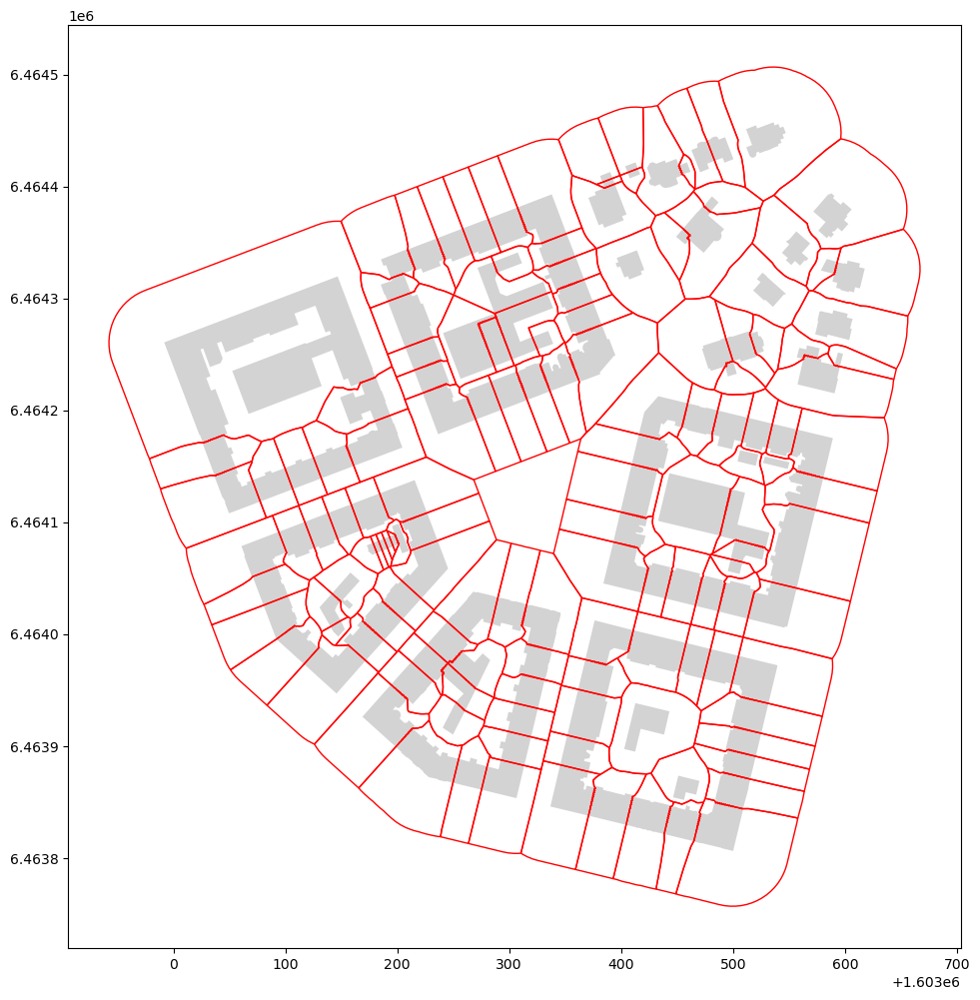

In [36]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    ax = bubenec_blg.plot(figsize=(12, 12), color="lightgray")
    bubenec_tess.plot(ax=ax, facecolor="none", edgecolor="r")
    w.plot(bubenec_blg, ax=ax, **wght_kws)
    contextily.add_basemap(ax=ax, crs=bubenec_tess.crs, source=toner_lite)
    ax.set_axis_off()

In [ ]:
queen_1 = libpysal.weights.contiguity.Queen.from_dataframe(
    tessellation, ids="uID", silence_warnings=True
)

In [ ]:
tessellation["neighbors"] = momepy.Neighbors(
    tessellation, queen_1, "uID", weighted=True
).series

In [ ]:
tessellation["covered_area"] = momepy.CoveredArea(tessellation, queen_1, "uID").series

In [ ]:
buildings["neighbor_distance"] = momepy.NeighborDistance(
    buildings, queen_1, "uID"
).series

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))
for i, (df, col) in enumerate(
    zip([tessellation, buildings], ["covered_area", "neighbor_distance"])
):
    df.plot(col, ax=ax[i], **symb_kws)
    ax[i].set_title(col, **font_kws)
    ax[i].set_axis_off()
fig.subplots_adjust(wspace=-.05)

In [ ]:
queen_3 = libpysal.weights.higher_order(queen_1, k=3, lower_order=True, silence_warnings=True)
buildings_q1 = libpysal.weights.contiguity.Queen.from_dataframe(
    buildings, silence_warnings=True
)
buildings["interbuilding_distance"] = momepy.MeanInterbuildingDistance(
    buildings, queen_1, "uID", queen_3
).series
buildings["adjacency"] = momepy.BuildingAdjacency(
    buildings, queen_3, "uID", buildings_q1
).series

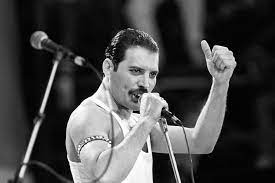

## What is a Queen?
# Contiguity-based Spatial Neighbors. • Sharing a border or boundary. 
– Rook: sharing a border. 
– Queen: sharing a border or a point

Visualizing actual shared-wall building adjacency:

In [ ]:
buildings_sample = libpysal.weights.contiguity.Queen.from_dataframe(
    bubenec_blg, silence_warnings=True
)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    ax = bubenec_blg.plot(figsize=(12, 12), color="lightgray")
    buildings_sample.plot(bubenec_blg, ax=ax, **wght_kws)
    bubenec_blg.centroid.plot(ax=ax, color='black')
    contextily.add_basemap(ax=ax, crs=bubenec_tess.crs, source=toner_lite)
    ax.set_axis_off()

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))
for i, col in enumerate(["interbuilding_distance", "adjacency"]):
    buildings.plot(col, ax=ax[i], **symb_kws)
    ax[i].set_title(col, **font_kws)
    ax[i].set_axis_off()
fig.subplots_adjust(wspace=-.05)

In [ ]:
profile = momepy.StreetProfile(streets, buildings)

In [ ]:
streets["width"] = profile.w

In [ ]:
streets["width_deviation"] = profile.wd

In [ ]:
streets["openness"] = profile.o

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(24, 12))
for i, col in enumerate(["width", "width_deviation", "openness"]):
    streets.plot(col, ax=ax[i], **symb_kws)
    ax[i].set_title(col, **font_kws)
    ax[i].set_axis_off()
fig.subplots_adjust(wspace=-.05)

#### Intensity

In [ ]:
tessellation["car"] = momepy.AreaRatio(
    tessellation, buildings, "area", "area", "uID"
).series

In [ ]:
ax = tessellation.plot("car", figsize=(12, 6), vmin=0, vmax=1, legend=True)
ax.set_title("covered area ratio", **font_kws)
ax.set_axis_off()

#### Connectivity

In [ ]:
graph = momepy.gdf_to_nx(streets)

In [ ]:
graph = momepy.node_degree(graph)
graph = momepy.closeness_centrality(graph, radius=400, distance="mm_len")
graph = momepy.meshedness(graph, radius=400, distance="mm_len")

In [ ]:
nodes, streets = momepy.nx_to_gdf(graph)

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(24, 12))
for i, col in enumerate(["degree", "closeness", "meshedness"]):
    if col == "closeness":
        lgnd_kwds = {"fmt": "{:.6f}"}
        nodes.plot(col, ax=ax[i], markersize=1, legend_kwds=lgnd_kwds, **symb_kws)
    else:
        nodes.plot(col, ax=ax[i], markersize=1, **symb_kws)
    ax[i].set_title(col, **font_kws)
    ax[i].set_axis_off()
fig.subplots_adjust(wspace=-.05)

In [ ]:
buildings["nodeID"] = momepy.get_node_id(buildings, nodes, streets, "nodeID", "nID")

Link all data together (to tessellation cells or buildings).

In [ ]:
tessellation

In [ ]:
merged = tessellation.merge(buildings.drop(columns=["nID", "geometry"]), on="uID", suffixes=('_tess', '_blg'))
merged = merged.merge(streets.drop(columns="geometry"), on="nID", how="left")
merged = merged.merge(nodes.drop(columns="geometry"), on="nodeID", how="left")
merged.columns

In [ ]:
merged

## Understanding context & clustering

### Context
Measure first, second, and third quartile of distribution of values within an area around each building.

In [22]:
drop_cols = ["uID", "nodeID", "nID", "mm_len", "node_start", "node_end", "geometry"]

In [ ]:
percentiles = []
for column in tqdm.auto.tqdm(merged.columns.drop(drop_cols)):
    perc = momepy.Percentiles(merged, column, queen_3, "uID", verbose=False).frame
    perc.columns = [f"{column}_" + str(x) for x in perc.columns]
    percentiles.append(perc)

In [ ]:
percentiles_joined = pandas.concat(percentiles, axis=1)
percentiles_joined

In [ ]:
merged["convexity_50"] = percentiles_joined["convexity_50"].values

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(24, 12))
for i, (df, col) in enumerate(
    zip([tessellation, merged], ["convexity", "convexity_50"])
):
    df.plot(col, ax=ax[i], **symb_kws)
    ax[i].set_title(col, **font_kws)
    ax[i].set_axis_off()
fig.subplots_adjust(wspace=-.05)

### Clustering

Standardize values before clustering with [`clustergram`](https://github.com/martinfleis/clustergram).

In [ ]:
standardized = (
    percentiles_joined - percentiles_joined.mean()
) / percentiles_joined.std()
standardized

#### How many clusters?

In [ ]:
cgram = clustergram.Clustergram(range(1, 12), n_init=10, random_state=0)
cgram.fit(standardized.fillna(0))

In [ ]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    show(cgram.bokeh())

In [ ]:
cgram.labels.head()

In [ ]:
merged["cluster"] = cgram.labels[8].values

In [ ]:
urban_types = buildings[["geometry", "uID"]].merge(merged[["uID", "cluster"]], on="uID")

In [ ]:
urban_types.explore(
    "cluster", categorical=True, prefer_canvas=True, tiles="CartoDB Positron",
)

Measuring diversity

Absolute values |
Relative values |
Categorization (binning)|

In [1]:
import momepy
import geopandas as gpd
import matplotlib.pyplot as plt

In [11]:
import osmnx as ox

gdf = ox.geometries.geometries_from_place('Sankt Gallen', tags={'building':True})
buildings = ox.projection.project_gdf(gdf)

buildings['uID'] = momepy.unique_id(buildings)
limit = momepy.buffered_limit(buildings)
tessellation = momepy.Tessellation(buildings, unique_id='uID', limit=limit).tessellation

/tmp/ipykernel_652/3927427522.py:3: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  gdf = ox.geometries.geometries_from_place('Sankt Gallen', tags={'building':True})


Inward offset...
Generating input point array...
Generating Voronoi diagram...
Generating GeoDataFrame...
Dissolving Voronoi polygons...


/tmp/ipykernel_652/3927427522.py:8: UserWarning: Tessellation does not fully match buildings. 3 element(s) collapsed during generation - unique_id: {0, 1, 2}.
  tessellation = momepy.Tessellation(buildings, unique_id='uID', limit=limit).tessellation
/tmp/ipykernel_652/3927427522.py:8: UserWarning: Tessellation contains MultiPolygon elements. Initial objects should  be edited. `unique_id` of affected elements: [8294, 9294, 8296, 5061, 2532, 9594, 3324, 5901].
  tessellation = momepy.Tessellation(buildings, unique_id='uID', limit=limit).tessellation


In [12]:
sw3 = momepy.sw_high(k=3, gdf=tessellation, ids='uID')

In [13]:
tessellation['area'] = momepy.Area(tessellation).series

Range

In [14]:
area_rng = momepy.Range(tessellation, values='area',
                                        spatial_weights=sw3, unique_id='uID')
tessellation['area_rng'] = area_rng.series

  0%|          | 0/9700 [00:00<?, ?it/s]

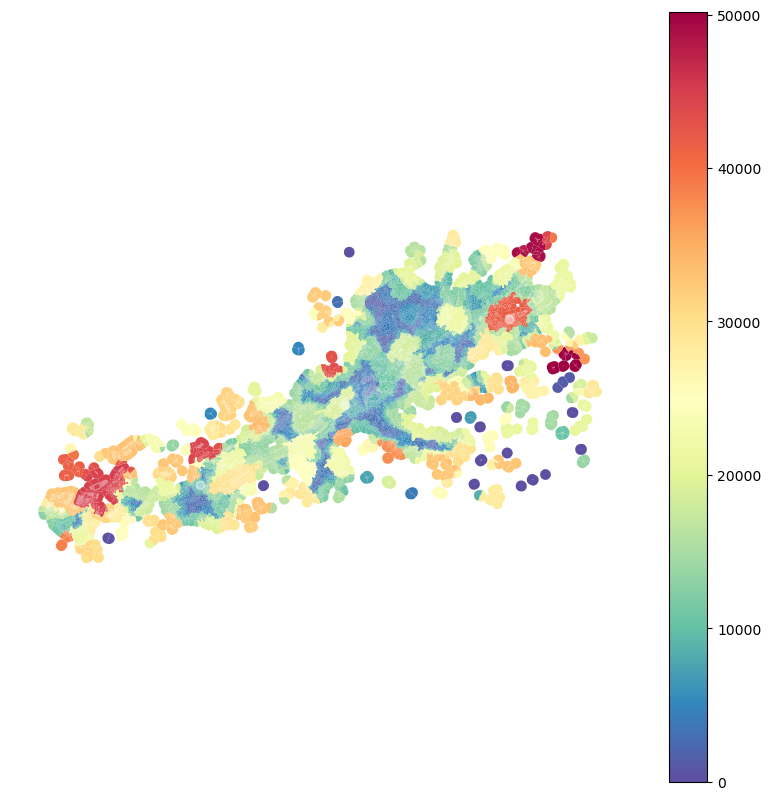

In [15]:
f, ax = plt.subplots(figsize=(10, 10))
tessellation.plot(ax=ax, column='area_rng', legend=True, cmap='Spectral_r')
buildings.plot(ax=ax, color="white", alpha=0.4)
ax.set_axis_off()
plt.show()

In [16]:
area_iqr = momepy.Range(tessellation, values='area',
                        spatial_weights=sw3, unique_id='uID',
                        rng=(25, 75))
tessellation['area_IQR'] = area_iqr.series

  0%|          | 0/9700 [00:00<?, ?it/s]

Remove outliers

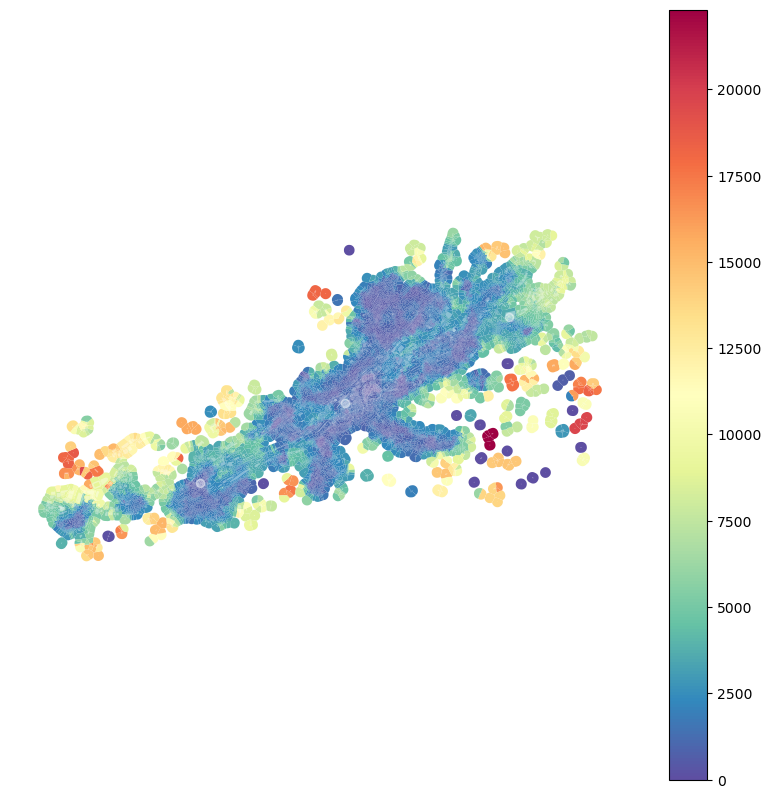

In [17]:
f, ax = plt.subplots(figsize=(10, 10))
tessellation.plot(ax=ax, column='area_IQR', legend=True, cmap='Spectral_r')
buildings.plot(ax=ax, color="white", alpha=0.4)
ax.set_axis_off()
plt.show()

Theil index

In [20]:
area_theil = momepy.Theil(tessellation, values='area',
                          spatial_weights=sw3,
                          unique_id='uID')
tessellation['area_Theil'] = area_theil.series

  0%|          | 0/9700 [00:00<?, ?it/s]

/home/conda/global/00b4745784c238b501a10c1a8fa84b198f8d2e54d6773c7aa5f6d56dbffafe97-20230711-001910-478977-54-answering-geospatial-questions/lib/python3.10/site-packages/mapclassify/classifiers.py:1860: UserWarning: Numba not installed. Using slow pure python version.
  warnings.warn(


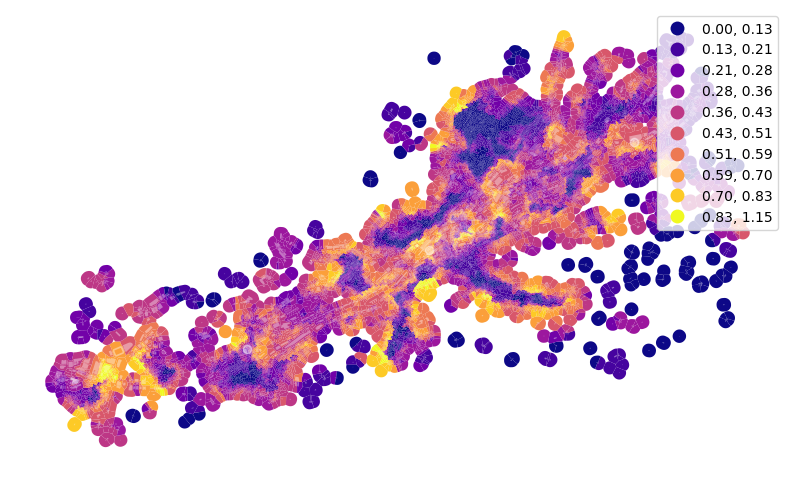

In [21]:
f, ax = plt.subplots(figsize=(10, 10))
tessellation.plot(ax=ax, column='area_Theil', scheme='fisherjenks', k=10, legend=True, cmap='plasma')
buildings.plot(ax=ax, color="white", alpha=0.4)
ax.set_axis_off()
plt.show()

higher number indicates higher entropic distance from the egalitarian state

The Theil index is part of a larger family of measures referred to as the General Entropy class. Compared to the Gini index, it has the advantage of being additive across different subgroups or regions in the country.(World Bank)

Wrap up



- `momepy` documentation ([docs.momepy.org](https://docs.momepy.org))
- real-life method to detect urban types ([github.com/martinfleis/numerical-taxonomy-paper](https://github.com/martinfleis/numerical-taxonomy-paper))


## References

* **Alessandro Araldi and Giovanni Fusco**. (2019) From the street to the metropolitan region: Pedestrian perspective in urban fabric analysis. *Environment and Planning B: Urban Analytics and City Science*. 46(7):1243–1263. doi: [10.1177/2399808319832612](https://doi.org/10.1177/2399808319832612).
* **Melih Basaraner and Sinan Cetinkaya**. (2017) Performance of shape indices and classification schemes for characterising perceptual shape complexity of building footprints in GIS. *International Journal of Geographical Information Science*. 31(10):1952–1977. doi: [10.1080/13658816.2017.1346257](https://doi.org/10.1080/13658816.2017.1346257).
* **Geoff Boeing.** (2017) OSMnx: New Methods for Acquiring, Constructing, Analyzing, and Visualizing Complex Street Networks. *Computers, Environment and Urban Systems* 65:126-139. doi: [10.1016/j.compenvurbsys.2017.05.004](https://doi.org/10.1016/j.compenvurbsys.2017.05.004).
* **Loeiz Bourdic, Serge Salat, and Caroline Nowacki**. (2012) Assessing cities: a new system of cross-scale spatial indicators. *Building Research & Information*. 40(5):592–605. doi: [10.1080/09613218.2012.703488](https://doi.org/10.1080/09613218.2012.703488).
* **Zofie Cimburova**. (2017) Urban Morphology in Prague: Automatic Classification in GIS. [PhD thesis](https://dspace.cvut.cz/handle/10467/67903). *Czech Technical University, Prague*.
* **Jacob Dibble et al**. (2017) On the origin of spaces: Morphometric foundations of urban form evolution. *Environment and Planning B: Urban Analytics and City Science*. 46(4):707–730. doi: [10.1177/2399808317725075](https://doi.org/).
* **Alessandra Feliciotti**. (2018) Resilience and urban design: A systems approach to the study of resilience in urban form – Learning from the case of the Gorbals. PhD thesis, *University of Strathclyde, Glasgow*. doi: [10.48730/yrsa-7747](https://doi.org/10.48730/yrsa-7747).
* **Martin Fleischmann**. (2019) momepy: Urban Morphology Measuring Toolkit. *Journal of Open Source Software*. 4(43):1807. doi: [10.21105/joss.01807](https://doi.org/10.21105/joss.01807).
* **Martin Fleischmann**. (2021). martinfleis/clustergram: v0.6.0 (v0.6.0). *Zenodo*. doi: [10.5281/zenodo.5680799](https://doi.org/10.5281/zenodo.5680799).
* **Martin Fleischmann et al**. (2020) Morphological tessellation as a way of partitioning space: Improving consistency in urban morphology at the plot scale. *Computers, Environment and Urban Systems*. 80:101441. doi: [10.1016/j.compenvurbsys.2019.101441](https://doi.org/10.1016/j.compenvurbsys.2019.101441).
* **Martin Fleischmann et al**. (2021) Methodological Foundation of a Numerical Taxonomy of Urban Form. *Environment and Planning B: Urban Analytics and City Science*. 49(4):1283-1299 doi: [10.1177/23998083211059835](https://doi.org/10.1177/23998083211059835).
* **Jorge Gil et al**. (2012) On the Discovery of Urban Typologies: Data Mining the Multi-dimensional Character of Neighbourhoods. *[Urban Morphology](http://www.urbanform.org/online_public/2012_1.shtml)*, [16(1):27–40](http://www.urbanform.org/online_unlimited/pdf2012/201216_27.pdf).
* **Rachid Hamaina, Thomas Leduc, and Guillaume Moreau**. (2012) Towards Urban Fabrics Characterization Based on Buildings Footprints. In *Bridging the Geographic Information Sciences*, 2:327–346. Springer, Berlin, Heidelberg. doi: [10.1007/978-3-642-29063-3_18](https://doi.org/10.1007/978-3-642-29063-3_18).
* **Birgit Hausleitner and Meta Berghauser Pont**. (2017) Development of a configurational typology for micro-businesses integrating geometric and configurational variables. In *11th Space Syntax Symposium*. [66:1-14](https://pure.tudelft.nl/ws/portalfiles/portal/51462127/Paer_66_book_proceedings_28092017.pdf).
* **Txomin Hermosilla et al**. (2012) Assessing contextual descriptive features for plot-based classification of urban areas. *Landscape and Urban Planning*, 106(1):124–137. doi: [10.1016/j.landurbplan.2012.02.008](https://doi.org/10.1016/j.landurbplan.2012.02.008).
* **Kelsey Jordahl et al**. (2022). geopandas/geopandas: v0.11.1 (v0.11.1). *Zenodo*. doi: [10.5281/zenodo.6894736](https://doi.org/10.5281/zenodo.6894736).
* **Kevin McGarigal and Barbara J. Marks**. (1995) FRAGSTATS: Spatial Pattern Analysis Program for Quantifying Landscape Structure. *Gen. Tech. Rep. PNW-GTR-351. Portland, OR: U.S. Department of Agriculture, Forest Service, Pacific Northwest Research Station*. doi: [10.2737/PNW-GTR-351](https://doi.org/10.2737/PNW-GTR-351).
* **Sergio Porta, Paolo Crucitti, and Vito Latora**. (2006) The network analysis of urban streets: A primal approach. *Environment and Planning B: Planning and Design*. 33(5):705–725. doi: [10.1068/b32045](https://doi.org/10.1068/b32045).
* **Sergio J. Rey et al**. (2021) The PySAL Ecosystem: Philosophy and Implementation. *Geographical Analysis*, 54(3):467–487. doi: [10.1111/gean.12276](https://doi.org/10.1111/gean.12276).
* **Patrick M. Schirmer and Kay W. Axhausen**. (2015) A multiscale classification of urban morphology. *Journal of Transport and Land Use*. 9(1):101–130. doi: [10.5198/jtlu.2015.667](https://doi.org/10.5198/jtlu.2015.667).
* **Pratyush Tripathy et al**. (2020) An open-source tool to extract natural continuity and hierarchy of urban street networks. *Environment and Planning B: Urban Analytics and City Science*. 48(8):2188-2205, doi: [10.1177/2399808320967680](https://doi.org/10.1177/2399808320967680).
* **Sven Vanderhaegen and Frank Canters**. (2017) Mapping urban form and function at city block level using spatial metrics. *Landscape and Urban Planning*. 167:399–409. doi: [10.1016/j.landurbplan.2017.05.023](https://doi.org/10.1016/j.landurbplan.2017.05.023).

## Acknowledgement

The following acknowledgement applies to James D. Gaboardi (affiliation 4) only:

> This manuscript has been authored in part by UT-Battelle LLC under contract DE- AC05-00OR22725 with the US Department of Energy (DOE). The US government retains and the publisher, by accepting the article for publication, acknowledges that the US government retains a nonexclusive, paid-up, irrevocable worldwide license to publish or reproduce the published form of this manuscript, or allow others to do so, for US government purposes. DOE will provide public access to these results of federally sponsored research in accordance with the DOE Public Access Plan (http://energy.gov/downloads/doe-public-access-plan).